<a href="https://colab.research.google.com/github/Anup8777/TensorFlow_DeepLearning/blob/master/Surabhi_Assignment2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Assignment 2 TensorBoard and tf.data!

In [1]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
import os
import datasets
import datetime

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [41]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Now starting up the TensorBoard in the background as:

In [0]:
logdir = os.path.join("logs", datetime.datetime.now( ).strftime("%Y%m%d-%H%M%S"))
#get_ipython().system_raw('tensorboard --logdir {} --host 0.0.0.0 --port 6006 &'.format(logdir))

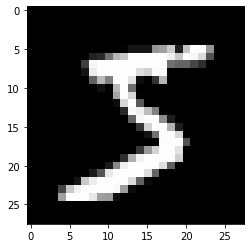

In [3]:
mnist = tf.keras.datasets.mnist
(train_images, train_labels), (test_images, test_labels) = mnist.load_data()

plt.imshow(train_images[0], cmap="Greys_r")

data = datasets.MNISTDataset(train_images.reshape([-1, 784]), train_labels, 
                    test_images.reshape([-1, 784]), test_labels,
                    batch_size=128)

In [0]:
train_writer = tf.summary.create_file_writer(os.path.join(logdir, "train"))
test_writer = tf.summary.create_file_writer(os.path.join(logdir, "test"))

## My model

In [0]:
hiddenlayer1 = 256
hiddenlayer2 = 128
hiddenlayer3 = 96
classes = 10
train_steps = int(1e3)
learning_rate = 0.1
train_acc, train_loss = [], []

In [0]:
# Weights

W1 = tf.Variable(tf.random.normal(shape=[784, hiddenlayer1], mean=0, stddev=0.1, seed=231, dtype=tf.dtypes.float32))
W2 = tf.Variable(tf.random.normal(shape=[hiddenlayer1, hiddenlayer2], mean=0, stddev=0.1, seed=231, dtype=tf.dtypes.float32))
W3 = tf.Variable(tf.random.normal(shape=[hiddenlayer2, hiddenlayer3], mean=0, stddev=0.1, seed=231, dtype=tf.dtypes.float32))
W4 = tf.Variable(tf.random.normal(shape=[hiddenlayer3, classes], mean=0, stddev=0.1, seed=231, dtype=tf.dtypes.float32))

B1 = tf.Variable(np.zeros(hiddenlayer1, dtype=np.float32))
B2 = tf.Variable(np.zeros(hiddenlayer2, dtype=np.float32))
B3 = tf.Variable(np.zeros(hiddenlayer3, dtype=np.float32))
B4 = tf.Variable(np.zeros(classes, dtype=np.float32))

In [0]:
def NN(data_ip):
  firstlayer_hlayer1 = tf.nn.relu(tf.add(tf.matmul(data_ip, W1), B1))
  hlayer1_hlayer2 = tf.nn.relu(tf.matmul(firstlayer_hlayer1, W2) + B2) 
  hlayer2_hlayer3 = tf.nn.relu(tf.matmul(hlayer1_hlayer2, W3) + B3)
  op_layer = tf.nn.softmax(tf.matmul(hlayer2_hlayer3, W4) + B4)
  return op_layer

In [0]:
for step in range(train_steps):
    img_batch, lbl_batch = data.next_batch()
    with tf.GradientTape(persistent=True) as tape:
        logits = NN(img_batch)
        xent = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
            logits=logits, labels=lbl_batch))
    grads = tape.gradient(xent, [W4, B4, W3, B3, W2, B2, W1,B1])

    W4.assign_sub(learning_rate * grads[0])
    B4.assign_sub(learning_rate * grads[1])

    W3.assign_sub(learning_rate * grads[2])
    B3.assign_sub(learning_rate * grads[3])
    
    W2.assign_sub(learning_rate * grads[4])
    B2.assign_sub(learning_rate * grads[5])

    W1.assign_sub(learning_rate * grads[6])
    B1.assign_sub(learning_rate * grads[7])
    
    with train_writer.as_default():
        tf.summary.scalar("loss", xent, step=step)
        tf.summary.histogram("logits", logits, step=step)
        tf.summary.histogram("weights", tf.matmul(tf.matmul(tf.matmul(W1, W2), W3), W4), step=step)
    
    if not step % 100:
        preds = tf.argmax(logits, axis=1, output_type=tf.int32)
        acc = tf.reduce_mean(tf.cast(tf.equal(preds, lbl_batch),
                             tf.float32))
        with train_writer.as_default():
            tf.summary.scalar("accuracy", acc, step=step)
            tf.summary.image("input", tf.reshape(img_batch, [-1, 28, 28, 1]), step=step)

        train_acc.append(acc)
        train_loss.append(np.float(xent))
        
        test_preds = tf.argmax(tf.matmul(data.test_data, tf.matmul(tf.matmul(tf.matmul(W1, W2), W3), W4)) + B4, axis=1, output_type=tf.int32)
        test_acc = tf.reduce_mean(tf.cast(tf.equal(test_preds, data.test_labels), tf.float32))
        with test_writer.as_default():
            tf.summary.scalar("accuracy", test_acc, step=step)
        
        print("Training Loss: {} Accuracy: {}".format(xent, acc))
        print("Test accuracy: {}\n".format(test_acc))

Training Loss: 2.308516025543213 Accuracy: 0.1015625
Test accuracy: 0.06129999831318855

Training Loss: 2.005430221557617 Accuracy: 0.5625
Test accuracy: 0.5001000165939331

Training Loss: 1.767059326171875 Accuracy: 0.7890625
Test accuracy: 0.6797000169754028

Training Loss: 1.6778771877288818 Accuracy: 0.8203125
Test accuracy: 0.7540000081062317

Training Loss: 1.5611250400543213 Accuracy: 0.90625
Test accuracy: 0.8181999921798706

Starting new epoch...
Training Loss: 1.5892596244812012 Accuracy: 0.8984375
Test accuracy: 0.8205000162124634

Training Loss: 1.5795198678970337 Accuracy: 0.90625
Test accuracy: 0.8134999871253967

Training Loss: 1.5727391242980957 Accuracy: 0.890625
Test accuracy: 0.8309999704360962



In [0]:
%load_ext tensorboard

In [0]:
%tensorboard --logdir logs

In [0]:
test_preds = tf.argmax(tf.matmul(data.test_data, tf.matmul(tf.matmul(tf.matmul(W1, W2), W3), W4)) + B4, axis=1,
                       output_type=tf.int32)

acc = tf.reduce_mean(tf.cast(tf.equal(test_preds, test_labels),
                             tf.float32))
print(acc)

## 

## Diagnosing Problems via Visualization

### Fail Script 1

In [0]:
import tensorflow as tf

from datasets import MNISTDataset
from time import time


# get the data
(train_imgs, train_lbls), (test_imgs, test_lbls) = tf.keras.datasets.mnist.load_data()
mnist = MNISTDataset(train_imgs.reshape((-1, 784)), train_lbls,
                     test_imgs.reshape((-1, 784)), test_lbls,
                     batch_size=256, seed=int(time()))


# define the model first, from input to output

# this is a super deep model, cool!
n_units = 100
n_layers = 8
w_range = 0.4

# just set up a "chain" of hidden layers
layers = []
for layer in range(n_layers):
    layers.append(tf.keras.layers.Dense(
        n_units, activation=tf.nn.relu,
        kernel_initializer=tf.initializers.RandomUniform(minval=-w_range,
                                                         maxval=w_range),
        bias_initializer=tf.initializers.constant(0.001)))

# finally add the output layer
layers.append(tf.keras.layers.Dense(
    10, kernel_initializer=tf.initializers.RandomUniform(minval=-w_range,
                                                         maxval=w_range)))

lr = 1e-3  # modified
for step in range(2000):
    img_batch, lbl_batch = mnist.next_batch()
    with tf.GradientTape() as tape:
        # here we just run all the layers in sequence via a for-loop
        out = img_batch
        for layer in layers:
            out = layer(out) + 1e-6 # modified
        xent = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
            logits=(out), labels=lbl_batch))

    weights = [var for l in layers for var in l.trainable_variables]
    grads = tape.gradient(xent, weights)
    for grad, var in zip(grads, weights):
        var.assign_sub(lr*grad)
    
    
    with train_writer.as_default():
        tf.summary.scalar("loss", xent, step=step)
        tf.summary.histogram("logits", out, step=step)
        tf.summary.histogram("weights", weights[0], step=step)

    if not step % 100:
        preds = tf.argmax(out, axis=1, output_type=tf.int32)
        acc = tf.reduce_mean(tf.cast(tf.equal(preds, lbl_batch), tf.float32))
        print("Loss: {} Accuracy: {}".format(xent, acc))

    with train_writer.as_default():
            tf.summary.scalar("accuracy", acc, step=step)
            tf.summary.image("input", tf.reshape(img_batch, [-1, 28, 28, 1]), step=step)

out = mnist.test_data
for layer in layers:
    out = layer(out)
test_preds = tf.argmax(out, axis=1, output_type=tf.int32)
acc = tf.reduce_mean(tf.cast(tf.equal(test_preds, mnist.test_labels), tf.float32))
print("Final test accuracy: {}".format(acc))


Loss: 126.12689208984375 Accuracy: 0.1484375
Loss: 3.991516590118408 Accuracy: 0.4453125
Loss: 2.300842523574829 Accuracy: 0.5
Starting new epoch...
Loss: 1.8811180591583252 Accuracy: 0.56640625
Loss: 1.929152011871338 Accuracy: 0.50390625
Starting new epoch...
Loss: 1.2899138927459717 Accuracy: 0.625
Loss: 1.299920678138733 Accuracy: 0.57421875
Loss: 1.2415823936462402 Accuracy: 0.6328125
Starting new epoch...
Loss: 1.2904441356658936 Accuracy: 0.63671875
Loss: 1.3446965217590332 Accuracy: 0.64453125
Starting new epoch...
Loss: 1.0881891250610352 Accuracy: 0.67578125
Loss: 0.9721461534500122 Accuracy: 0.703125
Starting new epoch...
Loss: 0.9657787084579468 Accuracy: 0.67578125
Loss: 1.1531718969345093 Accuracy: 0.66015625
Loss: 0.8583534955978394 Accuracy: 0.73828125
Starting new epoch...
Loss: 0.9690754413604736 Accuracy: 0.69921875
Loss: 0.8976285457611084 Accuracy: 0.72265625
Starting new epoch...
Loss: 0.7785723805427551 Accuracy: 0.76953125
Loss: 0.8645841479301453 Accuracy: 0.72

In [0]:
%load_ext tensorboard

In [0]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 2229), started 2:16:34 ago. (Use '!kill 2229' to kill it.)

<IPython.core.display.Javascript object>

Observing the plots above the following observations are made:


> 1.   The loss functions logs "0" values and various steps, this might be observed from tf.nn.sparse_softmax_cross_entropy_with_logits() as when logits=0, the log 0 is undefined or in this specific case the value is stored as NanN.

> 2.   Debugging this situation could be a liitle tricky and there might be couple of things to look for:
>> *   If we have some 0s or NaNs in the inputs to the NN
   *   This can also be encountered due to bad Normalisation techniques
   *   A higher learning rate can also cause these problems, as the gradients  computed can be vanished or could take large steps in either dirction causing the log value in the loss function to explode or go to NaN

**The Learning rate is modified in the above text to "1e-3", with this the performance of the network is decent enough. The weights can also take up NaN values when the loss goes to NaN. This can also be observed here. To avoid the log function returning NaN a small $\epsilon$ = $e^{-6}$ or $e^{-10}$ is added to the numbers causing these problems or can also be added directly to logits.**

Note: The lines modified are commented like "# modified" infront of them. Having a lower rate and seeing to it that loss does not get to NaN is the keyhere to make the algorithm work and to train and then predict.






### Fail Script 2

In [0]:
import tensorflow as tf

from datasets import MNISTDataset
from time import time


# get the data
(train_imgs, train_lbls), (test_imgs, test_lbls) = tf.keras.datasets.mnist.load_data()
mnist = MNISTDataset(train_imgs.reshape((-1, 784)), train_lbls,
                     test_imgs.reshape((-1, 784)), test_lbls,
                     batch_size=256, seed=int(time()))


# define the model first, from input to output

# this is a super deep model, cool!
n_units = 100
n_layers = 8
w_range = 1.25  # modified

# just set up a "chain" of hidden layers
layers = []
for layer in range(n_layers):
    layers.append(tf.keras.layers.Dense(
        n_units, activation=tf.nn.sigmoid,
        kernel_initializer=tf.initializers.RandomUniform(minval=-w_range,
                                                         maxval=w_range),
        bias_initializer=tf.initializers.constant(0.001)))

# finally add the output layer
layers.append(tf.keras.layers.Dense(
    10, kernel_initializer=tf.initializers.RandomUniform(minval=-w_range,
                                                         maxval=w_range)))

lr = 0.1
for step in range(2000):
    img_batch, lbl_batch = mnist.next_batch()
    with tf.GradientTape() as tape:
        # here we just run all the layers in sequence via a for-loop
        out = img_batch
        for layer in layers:
            out = layer(out)
        xent = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
            logits=out, labels=lbl_batch))

    weights = [var for l in layers for var in l.trainable_variables]
    grads = tape.gradient(xent, weights)
    for grad, var in zip(grads, weights):
        var.assign_sub(lr*grad)

    with train_writer.as_default():
        tf.summary.scalar("loss", xent, step=step)
        tf.summary.histogram("logits", out, step=step)
        tf.summary.histogram("weights", weights[0], step=step)

    if not step % 100:
        preds = tf.argmax(out, axis=1, output_type=tf.int32)
        acc = tf.reduce_mean(tf.cast(tf.equal(preds, lbl_batch), tf.float32))
        print("Loss: {} Accuracy: {}".format(xent, acc))

    with train_writer.as_default():
            tf.summary.scalar("accuracy", acc, step=step)
            tf.summary.image("input", tf.reshape(img_batch, [-1, 28, 28, 1]), step=step)

out = mnist.test_data
for layer in layers:
    out = layer(out)
test_preds = tf.argmax(out, axis=1, output_type=tf.int32)
acc = tf.reduce_mean(tf.cast(tf.equal(test_preds, mnist.test_labels), tf.float32))
print("Final test accuracy: {}".format(acc))

Loss: 5.946615695953369 Accuracy: 0.109375
Loss: 1.6457877159118652 Accuracy: 0.484375
Loss: 1.2252647876739502 Accuracy: 0.60546875
Starting new epoch...
Loss: 0.9308264851570129 Accuracy: 0.67578125
Loss: 0.8208332061767578 Accuracy: 0.7421875
Starting new epoch...
Loss: 0.7956278920173645 Accuracy: 0.70703125
Loss: 0.7413107752799988 Accuracy: 0.76171875
Loss: 0.600877046585083 Accuracy: 0.81640625
Starting new epoch...
Loss: 0.5382076501846313 Accuracy: 0.84375
Loss: 0.6682904958724976 Accuracy: 0.8046875
Starting new epoch...
Loss: 0.4927879869937897 Accuracy: 0.83984375
Loss: 0.4026094675064087 Accuracy: 0.8671875
Starting new epoch...
Loss: 0.4489501714706421 Accuracy: 0.86328125
Loss: 0.503746509552002 Accuracy: 0.85546875
Loss: 0.38421565294265747 Accuracy: 0.87890625
Starting new epoch...
Loss: 0.552698016166687 Accuracy: 0.8359375
Loss: 0.5619453191757202 Accuracy: 0.828125
Starting new epoch...
Loss: 0.4148971438407898 Accuracy: 0.859375
Loss: 0.42103493213653564 Accuracy: 

In [0]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 1895), started 0:57:48 ago. (Use '!kill 1895' to kill it.)

<IPython.core.display.Javascript object>

In [0]:
logdir

'logs/20200503-003028'

As the graphs indicate that there is no learning taking place. The loss function is always constant or to precisely say hovering around a very small value. The plots are attached below and shows the learning curve with accuracy and losses. 

In [0]:
from IPython.display import Math

The constant loss can be due to sevral reasons. On inspection and playing around with different laerning rates, the problem is boiled down to calculating the gradients and weight updates. The loss function looks realistic and unlike in the previous case it does not go to 0 or to NaN. Hence the problem can be further boiled down to weights update and weights initialisation.

Having a smaller learning rate gives us a clearer picture of the learning process. On having a smaller learning rate it shows that the loss function value remains the same even after completing numerous steps. 
> The gradient values computed may be 1 or any constants that keep the same     values.

> The activation functions can also play an importanat role in the learning process. Similarly, there can also be different measures to initialise weights for the respective activation functions. **Xavier glorot** weights initialisation method can be implemented for the weights initialisation to improve the performance of the Neural Network.

> The Xavier glorot method goes as follows:

$[-w, w]$ = $ \sqrt{6} / \sqrt{{n_i} + {n_{i+1}}}$ 

where:
1.   -w is the range of the weights,
2.   $n_i$ is the number of incoming connections
3.   $n_{i+}$ is the number of outgoing connections

Following this while initialisating the weights on the layers can help the Neural Network to achieve better performance and better test accuracy.


References:

1.   https://towardsdatascience.com/weight-initialization-in-neural-networks-a-journey-from-the-basics-to-kaiming-954fb9b47c79
2.   http://proceedings.mlr.press/v9/glorot10a/glorot10a.pdf



![alt text](https://drive.google.com/uc?id=1AbY5P4SPzNTf1KU7Mey9WnXSO46BBXyQ) The figure shows the decraesing loss function after the modification of the weights initialisation.

![alt text](https://drive.google.com/uc?id=1h86tfoFl3bUbbCPGRCNoj6P6Od8RfG3g)
The figure shows the improvement in the training accuracy after the modification of the weights initliasiation. Resulting in test accuracy of 87.2 %

### Fail Script 3

In [0]:
import tensorflow as tf

from datasets import MNISTDataset
from time import time


# get the data
(train_imgs, train_lbls), (test_imgs, test_lbls) = tf.keras.datasets.mnist.load_data()
mnist = MNISTDataset(train_imgs.reshape((-1, 784)), train_lbls,
                     test_imgs.reshape((-1, 784)), test_lbls,
                     batch_size=256, seed=int(time()))


# define the model first, from input to output

# let's use fewer layers...
n_units = 100
n_layers = 2

# just set up a "chain" of hidden layers
layers = []
for layer in range(n_layers):
    layers.append(tf.keras.layers.Dense(
        n_units, activation=tf.nn.relu,
        kernel_initializer=tf.initializers.RandomUniform(minval=-0.244,
                                                         maxval=0.244),
        bias_initializer=tf.initializers.constant(0.001)))

# finally add the output layer
layers.append(tf.keras.layers.Dense(
    10, kernel_initializer=tf.initializers.RandomUniform(minval=-0.01,
                                                         maxval=0.01)))

lr = 0.1
for step in range(2000):
    img_batch, lbl_batch = mnist.next_batch()
    with tf.GradientTape() as tape:
        # here we just run all the layers in sequence via a for-loop
        out = img_batch
        for layer in layers:
            out = layer(out)
        xent = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
            logits=out, labels=lbl_batch))

    weights = [var for l in layers for var in l.trainable_variables]
    grads = tape.gradient(xent, weights)
    for grad, var in zip(grads, weights):
        var.assign_sub(lr*grad)
    with train_writer.as_default():
        tf.summary.scalar("loss", xent, step=step)
        tf.summary.histogram("logits", out, step=step)
        tf.summary.histogram("weights", weights[0], step=step)

    if not step % 100:
        preds = tf.argmax(out, axis=1, output_type=tf.int32)
        acc = tf.reduce_mean(tf.cast(tf.equal(preds, lbl_batch), tf.float32))
        print("Loss: {} Accuracy: {}".format(xent, acc))

        with train_writer.as_default():
            tf.summary.scalar("accuracy", acc, step=step)
            tf.summary.image("input", tf.reshape(img_batch, [-1, 28, 28, 1]), step=step)


out = mnist.test_data
for layer in layers:
    out = layer(out)
test_preds = tf.argmax(out, axis=1, output_type=tf.int32)
acc = tf.reduce_mean(tf.cast(tf.equal(test_preds, mnist.test_labels), tf.float32))
print("Final test accuracy: {}".format(acc))


Loss: 2.300055503845215 Accuracy: 0.0703125
Loss: 0.48980391025543213 Accuracy: 0.859375
Loss: 0.3915853500366211 Accuracy: 0.875
Starting new epoch...
Loss: 0.2869182825088501 Accuracy: 0.91015625
Loss: 0.2807353436946869 Accuracy: 0.92578125
Starting new epoch...
Loss: 0.2580149471759796 Accuracy: 0.9140625
Loss: 0.30357664823532104 Accuracy: 0.921875
Loss: 0.237974151968956 Accuracy: 0.94921875
Starting new epoch...
Loss: 0.25195828080177307 Accuracy: 0.93359375
Loss: 0.1808098554611206 Accuracy: 0.921875
Starting new epoch...
Loss: 0.15614274144172668 Accuracy: 0.9453125
Loss: 0.17644727230072021 Accuracy: 0.9609375
Starting new epoch...
Loss: 0.1819372922182083 Accuracy: 0.9453125
Loss: 0.17949523031711578 Accuracy: 0.9453125
Loss: 0.13335469365119934 Accuracy: 0.96484375
Starting new epoch...
Loss: 0.1254352331161499 Accuracy: 0.96875
Loss: 0.1982397735118866 Accuracy: 0.92578125
Starting new epoch...
Loss: 0.12150026857852936 Accuracy: 0.97265625
Loss: 0.1316307783126831 Accurac

In [0]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [0]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 206), started 0:32:10 ago. (Use '!kill 206' to kill it.)

<IPython.core.display.Javascript object>

In [0]:
logdir

'logs/20200503-222217'

The problem noticed here is the same as above script. The weight initialisations for the ReLU activation functions here are between [-0.01, 0]. Similarly as discussed above the ReLU activation functions with **He initialization** are proven to perform better. The He initialisation is described as 

$[-w, w]$ = $ \sqrt{6/ fall_{in}}$

where fall in is the number of connection coming in to the network. Following the same method and applying the **He initialisation** technique we get the weight distribution values to 0.244. Therefore, using -0.244 as minimum value and 0.244 as maximum values for weight initialisations for the ReLU activation functions. Using this means gives us an amazing test accuracy of 95.69 %. The plots and comaprison are put down below.

![alt text](https://drive.google.com/uc?id=1P8HxI4DiYwj89pssshr-eyv5xX6x_HNi)

The figure shows the weight distribution before and after applying **He** Initialisation technique.

![alt text](https://drive.google.com/uc?id=1ASOFZXxvSUOUVyqJMhyxeMmGgaoEA3ls)

The figure shows the loss value before and after applying **He** Initialisation technique.

![alt text](https://drive.google.com/uc?id=15jKP6h_3eYYWU-hmtMXzryTb21-hzhJj)

The figure shows the accuracy before and after applying **He** Initialisation technique.

### Fail Script 4

In [0]:
import tensorflow as tf

from datasets import MNISTDataset
from time import time


# get the data
(train_imgs, train_lbls), (test_imgs, test_lbls) = tf.keras.datasets.mnist.load_data()
mnist = MNISTDataset(train_imgs.reshape((-1, 784)), train_lbls,
                     test_imgs.reshape((-1, 784)), test_lbls,
                     batch_size=256, seed=int(time()))


# define the model first, from input to output

# let's use fewer layers...
n_units = 100
n_layers = 2

# just set up a "chain" of hidden layers
layers = []
for layer in range(n_layers):
    layers.append(tf.keras.layers.Dense(
        n_units, activation=tf.nn.relu,
        kernel_initializer=tf.initializers.RandomUniform(minval=-0.01,
                                                         maxval=0.01),
        bias_initializer=tf.initializers.constant(0.001)))

# finally add the output layer
layers.append(tf.keras.layers.Dense(
    10, kernel_initializer=tf.initializers.RandomUniform(minval=-0.01,
                                                         maxval=0.01)))

lr = 0.1
for step in range(2000):
    img_batch, lbl_batch = mnist.next_batch()
    # I hear adding random noise to inputs helps with generalization!
    img_batch = img_batch + tf.random.normal(tf.shape(img_batch), stddev=0.1)
    with tf.GradientTape() as tape:
        # here we just run all the layers in sequence via a for-loop
        out = img_batch
        for layer in layers:
            out = layer(out)
        xent = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
            logits=out, labels=lbl_batch))

    weights = [var for l in layers for var in l.trainable_variables]
    grads = tape.gradient(xent, weights)
    for grad, var in zip(grads, weights):
        var.assign_sub(lr*grad)

    with train_writer.as_default():
        tf.summary.scalar("loss", xent, step=step)
        tf.summary.histogram("logits", out, step=step)
        tf.summary.histogram("weights", weights[0], step=step)

    if not step % 100:
        preds = tf.argmax(out, axis=1, output_type=tf.int32)
        acc = tf.reduce_mean(tf.cast(tf.equal(preds, lbl_batch), tf.float32))
        print("Loss: {} Accuracy: {}".format(xent, acc))

    with train_writer.as_default():
            tf.summary.scalar("accuracy", acc, step=step)
            tf.summary.image("input", tf.reshape(img_batch, [-1, 28, 28, 1]), step=step)


out = mnist.test_data
for layer in layers:
    out = layer(out)
test_preds = tf.argmax(out, axis=1, output_type=tf.int32)
acc = tf.reduce_mean(tf.cast(tf.equal(test_preds, mnist.test_labels), tf.float32))
print("Final test accuracy: {}".format(acc))


Loss: 2.3025875091552734 Accuracy: 0.10546875
Loss: 2.3019587993621826 Accuracy: 0.11328125
Loss: 2.3053195476531982 Accuracy: 0.07421875
Starting new epoch...
Loss: 2.3051023483276367 Accuracy: 0.08203125
Loss: 2.293321132659912 Accuracy: 0.1328125
Starting new epoch...
Loss: 2.23834228515625 Accuracy: 0.23828125
Loss: 1.6064836978912354 Accuracy: 0.41796875
Loss: 0.8010859489440918 Accuracy: 0.73046875
Starting new epoch...
Loss: 0.5591250658035278 Accuracy: 0.83203125
Loss: 0.48742276430130005 Accuracy: 0.8515625
Starting new epoch...
Loss: 0.5764328837394714 Accuracy: 0.8046875
Loss: 0.566420316696167 Accuracy: 0.84375
Starting new epoch...
Loss: 0.47667011618614197 Accuracy: 0.86328125
Loss: 0.3496268391609192 Accuracy: 0.87109375
Loss: 0.3354202210903168 Accuracy: 0.88671875
Starting new epoch...
Loss: 0.31823837757110596 Accuracy: 0.8984375
Loss: 0.26722702383995056 Accuracy: 0.92578125
Starting new epoch...
Loss: 0.36023375391960144 Accuracy: 0.875
Loss: 0.23468345403671265 Acc

In [0]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [0]:
%tensorboard --logdir logs

In [0]:
logdir

'logs/20200503-232520'

Adding some noise to the input images or to the outputs of the hidden layers can help the model generalise better. However adding uniform noise with standard deviation destroys the image. Usually the noise is added to make the network robust. the above code is modified by changing the standard deviation from 4 to 0.1. The change improve the performance of the network to 93 %. However, one should be careful not to destroy the network with adverserial attacks with noise to inputs. 

The below image shows the input images with noise with 4 as standard deviation.


![alt text](https://drive.google.com/uc?id=1geW_UA4Al4h0iVQ_YATdrnCMBkODQ4we)

### Fail Script 5

In [5]:
import tensorflow as tf

from datasets import MNISTDataset
from time import time


# get the data
(train_imgs, train_lbls), (test_imgs, test_lbls) = tf.keras.datasets.mnist.load_data()
mnist = MNISTDataset(train_imgs.reshape((-1, 784)), train_lbls,
                     test_imgs.reshape((-1, 784)), test_lbls,
                     batch_size=256, seed=int(time()))


# define the model first, from input to output

# let's use fewer layers...
n_units = 100
n_layers = 2

# just set up a "chain" of hidden layers
layers = []
for layer in range(n_layers):
    layers.append(tf.keras.layers.Dense(
        n_units, activation=tf.nn.relu,
        kernel_initializer=tf.initializers.RandomUniform(minval=-0.1,
                                                         maxval=0.1), # modified
        bias_initializer=tf.initializers.constant(0.001)))

# finally add the softmax output layer :))
layers.append(tf.keras.layers.Dense(
    10, activation=tf.nn.softmax,
    kernel_initializer=tf.initializers.RandomUniform(minval=-0.01,
                                                     maxval=0.01)))

lr = 0.1
for step in range(2000):
    img_batch, lbl_batch = mnist.next_batch()
    with tf.GradientTape() as tape:
        # here we just run all the layers in sequence via a for-loop
        out = img_batch
        for layer in layers:
            out = layer(out)
        xent = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
            logits=out, labels=lbl_batch))

    weights = [var for l in layers for var in l.trainable_variables]
    grads = tape.gradient(xent, weights)
    for grad, var in zip(grads, weights):
        var.assign_sub(lr*grad)
     
    with train_writer.as_default():
        tf.summary.scalar("loss", xent, step=step)
        tf.summary.histogram("logits", out, step=step)
        tf.summary.histogram("weights", weights[0], step=step)

    if not step % 100:
        preds = tf.argmax(out, axis=1, output_type=tf.int32)
        acc = tf.reduce_mean(tf.cast(tf.equal(preds, lbl_batch), tf.float32))
        print("Loss: {} Accuracy: {}".format(xent, acc))

    with train_writer.as_default():
            tf.summary.scalar("accuracy", acc, step=step)
            tf.summary.image("input", tf.reshape(img_batch, [-1, 28, 28, 1]), step=step)

    


out = mnist.test_data
for layer in layers:
    out = layer(out)
test_preds = tf.argmax(out, axis=1, output_type=tf.int32)
acc = tf.reduce_mean(tf.cast(tf.equal(test_preds, mnist.test_labels), tf.float32))
print("Final test accuracy: {}".format(acc))

Loss: 2.302583932876587 Accuracy: 0.09375
Loss: 2.3025660514831543 Accuracy: 0.1171875
Loss: 2.3024213314056396 Accuracy: 0.15625
Starting new epoch...
Loss: 2.3027443885803223 Accuracy: 0.08984375
Loss: 2.3025238513946533 Accuracy: 0.11328125
Starting new epoch...
Loss: 2.302520275115967 Accuracy: 0.0859375
Loss: 2.302738666534424 Accuracy: 0.07421875
Loss: 2.302011013031006 Accuracy: 0.15625
Starting new epoch...
Loss: 2.302427053451538 Accuracy: 0.109375
Loss: 2.302194595336914 Accuracy: 0.125
Starting new epoch...
Loss: 2.302279472351074 Accuracy: 0.125
Loss: 2.301835298538208 Accuracy: 0.12890625
Starting new epoch...
Loss: 2.3020825386047363 Accuracy: 0.12109375
Loss: 2.30222749710083 Accuracy: 0.09765625
Loss: 2.301769733428955 Accuracy: 0.140625
Starting new epoch...
Loss: 2.3026793003082275 Accuracy: 0.08203125
Loss: 2.3022189140319824 Accuracy: 0.109375
Starting new epoch...
Loss: 2.3024754524230957 Accuracy: 0.08203125
Loss: 2.3025217056274414 Accuracy: 0.09375
Starting new 

In [0]:
%load_ext tensorboard

In [7]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 206), started 0:45:33 ago. (Use '!kill 206' to kill it.)

<IPython.core.display.Javascript object>

In [8]:
logdir

'logs/20200504-224528'

The weight initialisation of the MLP plays an important role in training the model. Here the initalisation of weights are very small and they are the same for all layers, this creates two types of problems for the learning process they are:


> 1. **Break the Symmetry**:

> This part is an essential part in training the NN.  Initialising all the weights of the NN to the same value (e.g. zero or one). In this case, each hidden unit will get exactly the same signal. E.g. if all weights are initialized to 1, each unit gets signal equal to sum of inputs (and outputs sigmoid(sum(inputs))). Irrespective of the input - if all weights are the same, all units in hidden layer will be the same too.

> 2. **Driving Gradients to zero**
> Gradients take a prominient part in traing the NN. When the gardient value takes zero there is no learning happening. Having, very low weights and when all the hidden layers have the same weight initialisations, the gradient values can go to 0. This can be a serious problem while training the NN. When the limits of the weight initialisations are relatively large the learning can be better without any gradients going to 0. 


![alt text](https://drive.google.com/uc?id=1DgGhSkzAIRNGGWevThS4-b5kQd3SKP5R)

![alt text](https://drive.google.com/uc?id=15jKP6h_3eYYWU-hmtMXzryTb21-hzhJj)

The behaviour of the NN with weights ranging between [-0.1, 0.1] and [-0.01, 0.01]. Clearly, the NN with initial weights between [-0.1, 0.1] performs much better.


References:

https://stackoverflow.com/questions/20027598/why-should-weights-of-neural-networks-be-initialized-to-random-numbers

https://machinelearningmastery.com/how-to-avoid-exploding-gradients-in-neural-networks-with-gradient-clipping/

